# Image Classification
# ViTForImageClassification

In [2]:
from transformers import ViTFeatureExtractor, ViTForImageClassification
from PIL import Image
import requests
import torch
import pprint

In [3]:
from PIL import Image

def predict_image(path: str, topk=10) -> dict:
    image = Image.open(path)
    image.show()
    feature_extractor = ViTFeatureExtractor.from_pretrained("google/vit-base-patch16-224")
    inputs = feature_extractor(image, return_tensors="pt")
    model = ViTForImageClassification.from_pretrained("google/vit-base-patch16-224")
    outputs = model(**inputs)
    probabilities = outputs.logits.softmax(-1)[0]
    scores, ids = probabilities.topk(topk)
    predictions = [{"score": score.item(), "label": model.config.id2label[_id.item()]} for score, _id in zip(scores, ids)]
    pprint.pprint(predictions)


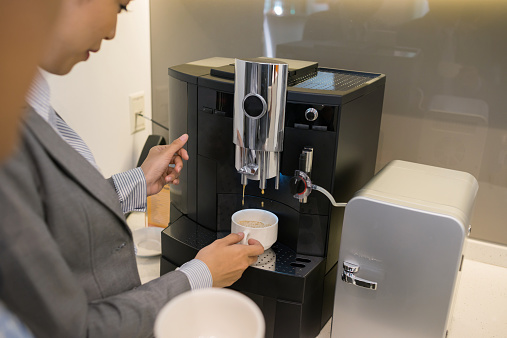

[{'label': 'espresso maker', 'score': 0.7207674384117126},
 {'label': 'soap dispenser', 'score': 0.17060710489749908},
 {'label': 'espresso', 'score': 0.011594833806157112},
 {'label': 'beaker', 'score': 0.009564246982336044},
 {'label': 'vending machine', 'score': 0.004377970937639475},
 {'label': 'paper towel', 'score': 0.004222060553729534},
 {'label': 'refrigerator, icebox', 'score': 0.003912440966814756},
 {'label': 'coffeepot', 'score': 0.0038929253350943327},
 {'label': 'printer', 'score': 0.0034088408574461937},
 {'label': 'desktop computer', 'score': 0.003263672813773155}]


In [4]:
predict_image("images/coffee-machine-in-office.jpeg")

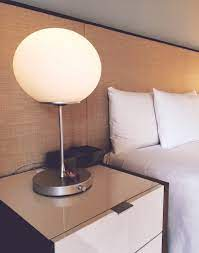

[{'label': 'table lamp', 'score': 0.8768282532691956},
 {'label': 'lampshade, lamp shade', 'score': 0.04565664380788803},
 {'label': 'studio couch, day bed', 'score': 0.0283699631690979},
 {'label': 'quilt, comforter, comfort, puff', 'score': 0.008491567336022854},
 {'label': 'spotlight, spot', 'score': 0.005910093430429697},
 {'label': 'four-poster', 'score': 0.00466418219730258},
 {'label': 'wardrobe, closet, press', 'score': 0.0023703505285084248},
 {'label': 'chiffonier, commode', 'score': 0.002060243859887123},
 {'label': 'desk', 'score': 0.0016790693625807762},
 {'label': 'shoji', 'score': 0.0016756540862843394}]


In [5]:
predict_image("images/lamp-in-hotel-room.jpeg")

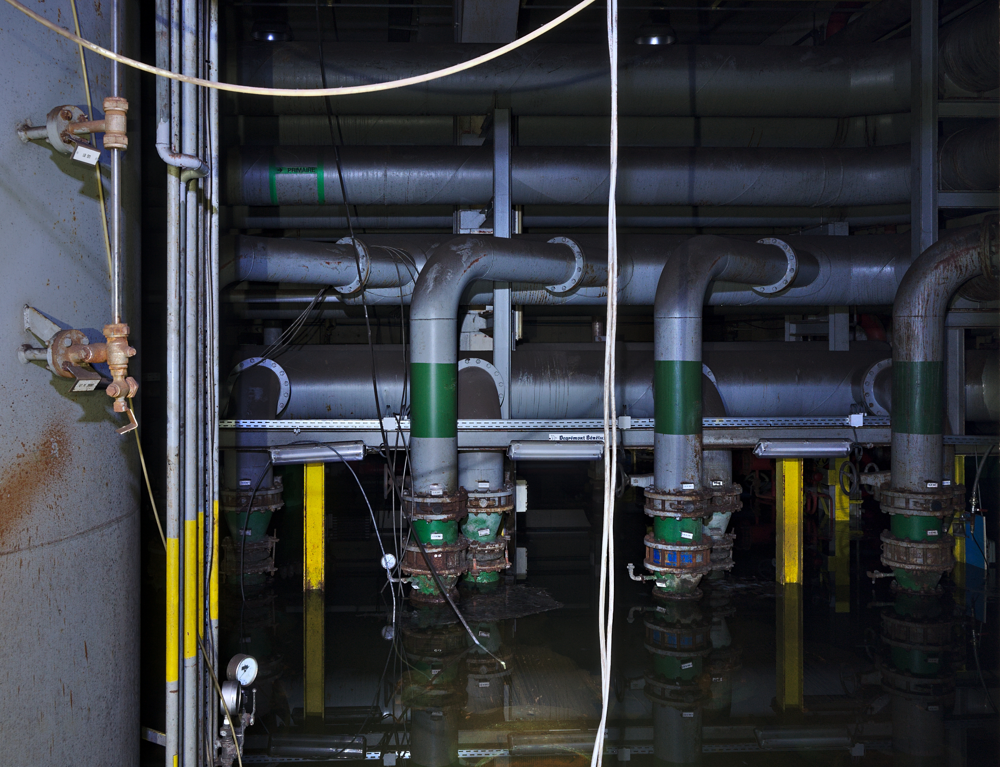

[{'label': 'pole', 'score': 0.1889866590499878},
 {'label': 'drilling platform, offshore rig', 'score': 0.07239136099815369},
 {'label': 'barrel, cask', 'score': 0.054703984409570694},
 {'label': 'water tower', 'score': 0.027051938697695732},
 {'label': 'oil filter', 'score': 0.020622506737709045},
 {'label': 'rain barrel', 'score': 0.018613433465361595},
 {'label': 'hook, claw', 'score': 0.0177544504404068},
 {'label': 'oxygen mask', 'score': 0.016612403094768524},
 {'label': 'switch, electric switch, electrical switch',
  'score': 0.014375114813446999},
 {'label': 'dock, dockage, docking facility', 'score': 0.01270070020109415}]


In [7]:
predict_image("images/pipes-in-water-factory.jpeg")

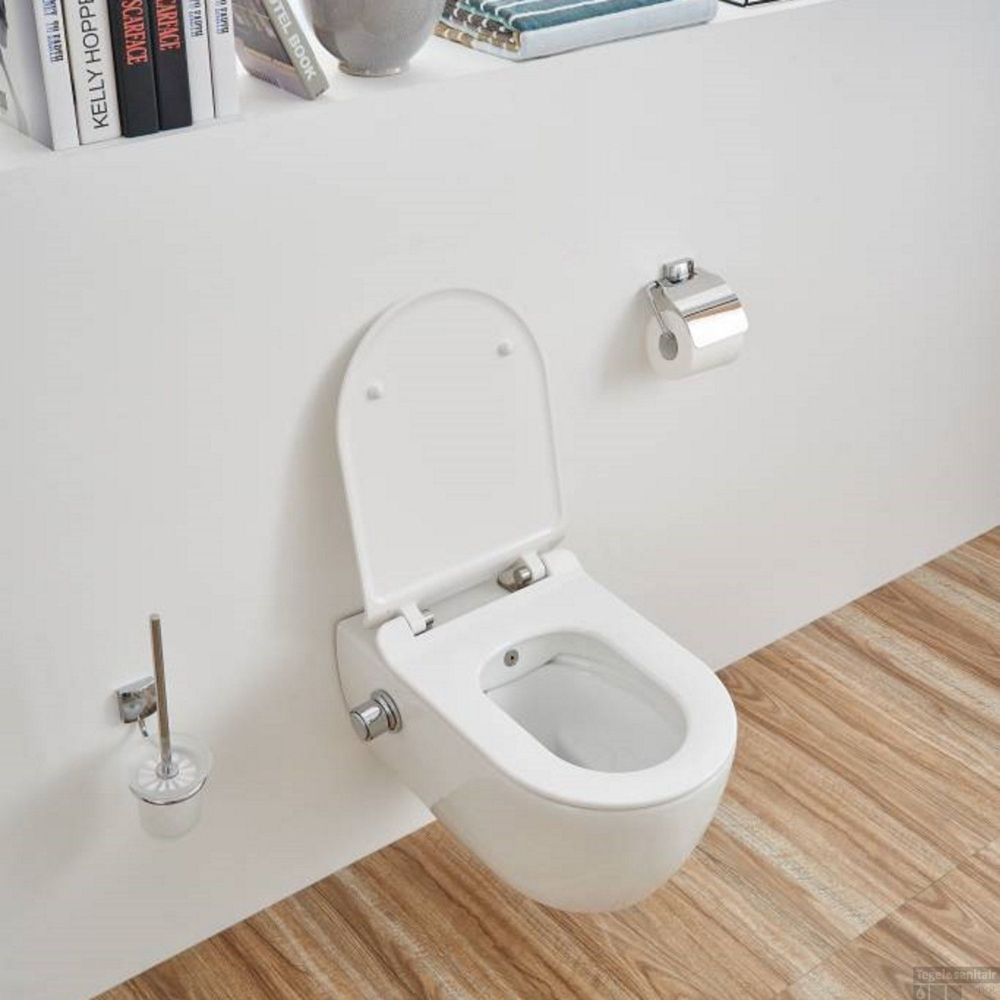

[{'label': 'toilet seat', 'score': 0.9319304823875427},
 {'label': "plunger, plumber's helper", 'score': 0.030165763571858406},
 {'label': 'washbasin, handbasin, washbowl, lavabo, wash-hand basin',
  'score': 0.011812790296971798},
 {'label': 'toilet tissue, toilet paper, bathroom tissue',
  'score': 0.010847890749573708},
 {'label': 'bathtub, bathing tub, bath, tub', 'score': 0.0022611080203205347},
 {'label': 'tub, vat', 'score': 0.002163655124604702},
 {'label': 'shower curtain', 'score': 0.0006130285328254104},
 {'label': 'mortar', 'score': 0.0005080016562715173},
 {'label': 'soap dispenser', 'score': 0.000413369300076738},
 {'label': 'medicine chest, medicine cabinet', 'score': 0.0003618340124376118}]


In [6]:
predict_image("images/toilet-in-office.jpg")

# Image Classification using a Pipeline

In [1]:
from transformers import pipeline
from PIL import Image
import requests

clf = pipeline("image-classification")

2022-02-19 08:54:19.815157: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-02-19 08:54:19.815194: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
No model was supplied, defaulted to google/vit-base-patch16-224 (https://huggingface.co/google/vit-base-patch16-224)


In [2]:
url = 'http://images.cocodataset.org/val2017/000000039769.jpg'
image = Image.open(requests.get(url, stream=True).raw)

In [6]:
clf(url)

[{'score': 0.9374412894248962, 'label': 'Egyptian cat'},
 {'score': 0.038442566990852356, 'label': 'tabby, tabby cat'},
 {'score': 0.014411398209631443, 'label': 'tiger cat'},
 {'score': 0.003274323185905814, 'label': 'lynx, catamount'},
 {'score': 0.0006795922527089715, 'label': 'Siamese cat, Siamese'}]